### **Mount Google Drive**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **Import Pustaka dan Modul yang diperlukan**

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization, Dropout, Flatten, Dense, Activation, MaxPooling2D
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.utils import plot_model

### **Buka Direktori Dataset**

In [4]:
import pathlib

# Definisikan path ke direktori gambar di Google Drive
data_dir = pathlib.Path('/content/drive/MyDrive/Herbalv2')

# Hitung jumlah gambar
image_count = len(list(data_dir.glob('*/*.jpg')))
print('Image Count :', image_count)

Image Count : 10000


### **Preprocessing**

In [ ]:
# Tentukan tinggi dan lebar gambar
img_height = 224
img_width = 224

# Buat dataset pelatihan
train_data = image_dataset_from_directory(
    data_dir,
    seed=123,
    image_size=(img_height, img_width),
    validation_split=0.2,
    subset='training'
)

# Buat dataset validasi
val_data = image_dataset_from_directory(
    data_dir,
    seed=123,
    image_size=(img_height, img_width),
    validation_split=0.1,
    subset='validation'
)

# Buat dataset pengujian
test_data = image_dataset_from_directory(
    data_dir,
    seed=123,
    image_size=(img_height, img_width),
    validation_split=0.1,
    subset='validation'
)

Found 10000 files belonging to 10 classes.
Using 8000 files for training.
Found 10000 files belonging to 10 classes.
Using 1000 files for validation.
Found 10000 files belonging to 10 classes.
Using 1000 files for validation.


In [ ]:
#cek label
from pathlib import Path
image_dir = Path('/content/drive/MyDrive/Herbal')

#uji dir
uji_dir = Path('/content/drive/MyDrive/Herbalv2')

In [ ]:
# Get filepaths and labels
filepaths_ = list(Path(image_dir).rglob('*.jpg'))
labels_ = [path.parent.name for path in filepaths_]

# Get filepaths and labels uji
filepaths_uji = list(Path(uji_dir).rglob('*.jpg'))
labels_uji = [path.parent.name for path in filepaths_uji]
print(labels_uji)

['Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 'Asoka', 

Class names: ['Asoka', 'Bunga Telang', 'Daun Jambu Biji', 'Daun Jarak', 'Daun Jeruk Nipis', 'Daun Kayu Putih', 'Daun Pepaya', 'Daun Sirih', 'Lidah Buaya', 'Semanggi']


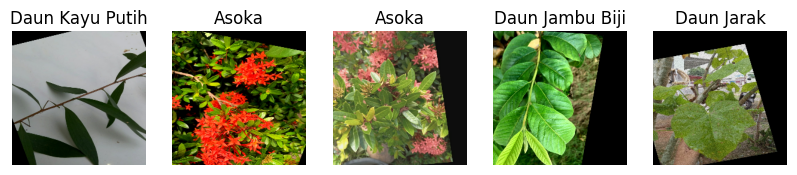

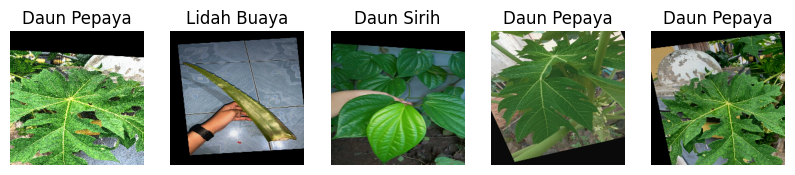

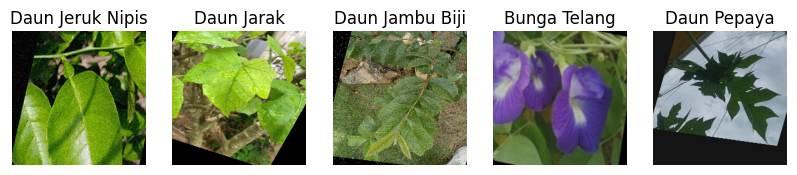

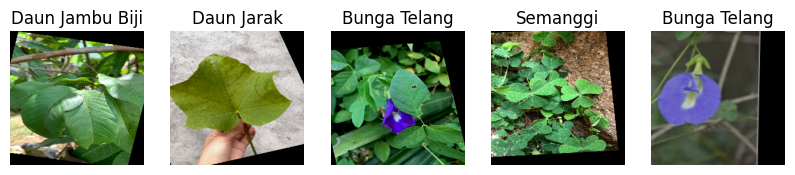

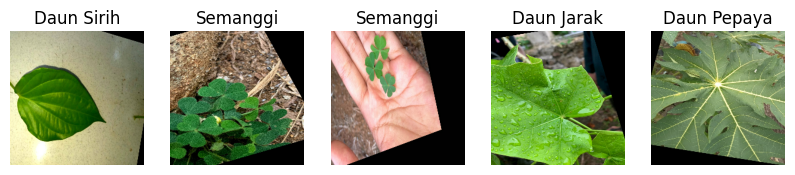

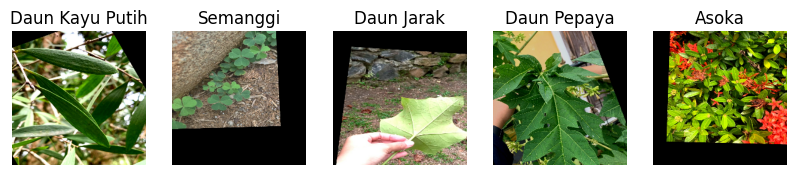

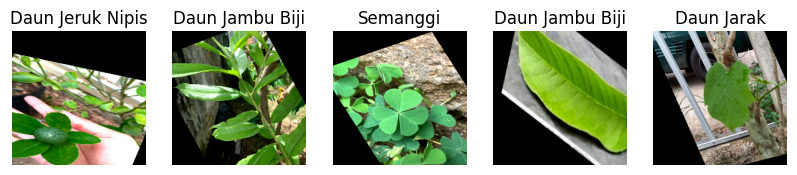

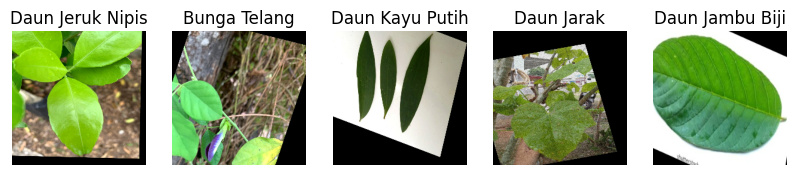

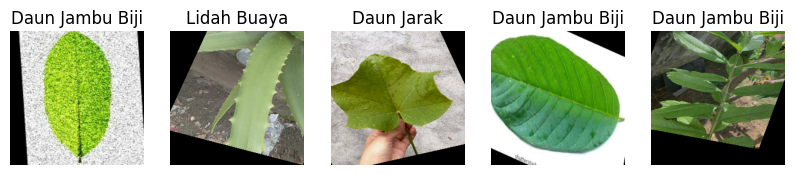

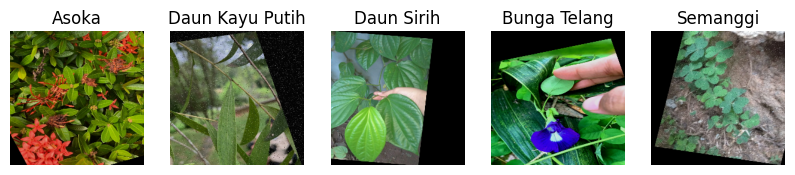

In [ ]:
import pathlib

# Ambil batch pertama dari dataset pelatihan
class_names = train_data.class_names
print('Class names:', class_names)

def plot_images(dataset, class_names, num_images=5):
    plt.figure(figsize=(10, 10))
    for images, labels in dataset.take(1):
        for i in range(num_images):
            ax = plt.subplot(1, num_images, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(class_names[labels[i]])
            plt.axis("off")

# Tampilkan beberapa gambar dari setiap kelas
for class_name in class_names:
    filtered_data = train_data.filter(lambda x, y: tf.reduce_any(tf.equal(y, class_names.index(class_name))))
    plot_images(filtered_data, class_names)

plt.show()


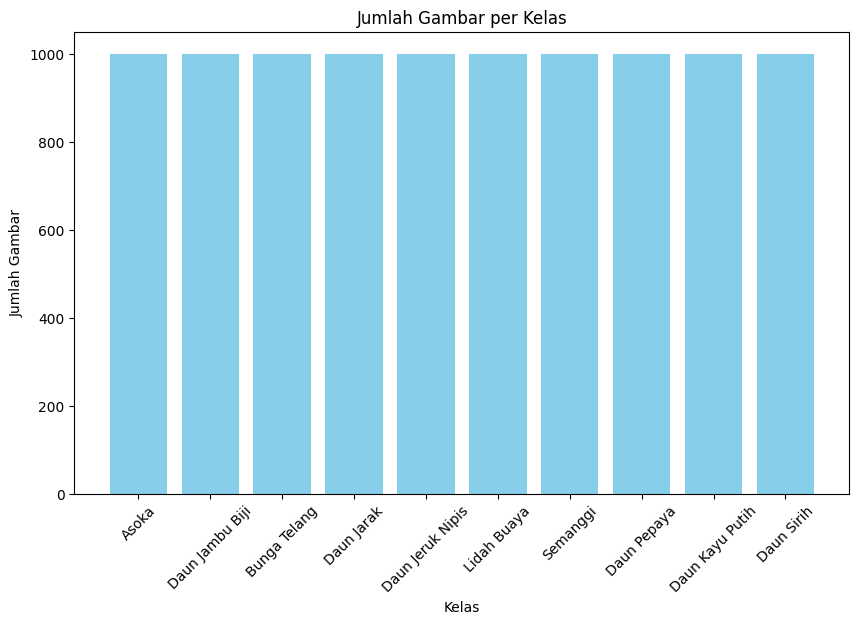

In [ ]:
# Definisikan path ke direktori gambar di Google Drive
data_dir = pathlib.Path('/content/drive/MyDrive/Herbalv2')

# Hitung jumlah gambar per kelas
classes = [d.name for d in data_dir.glob('*') if d.is_dir()]
image_counts_per_class = {cls: len(list(data_dir.glob(f"{cls}/*.jpg"))) for cls in classes}

# Buat grafik
plt.figure(figsize=(10, 6))
plt.bar(image_counts_per_class.keys(), image_counts_per_class.values(), color='skyblue')
plt.xlabel('Kelas')
plt.ylabel('Jumlah Gambar')
plt.title('Jumlah Gambar per Kelas')
plt.xticks(rotation=45)
plt.show()


### **Build EfficientNetV2B0 Model**

In [5]:
base_model = EfficientNetV2B0(input_shape=(224,224,3),include_top=False,weights="imagenet")

24274472/24274472 [==============================] - 0s 0us/step


In [ ]:
model = Sequential(name='EfficientNetV2B0')
model.add(base_model)
model.add(MaxPooling2D())
model.add(Dropout(0.5))
model.add(Flatten())
model.add(BatchNormalization())
model.add(Dense(128, kernel_initializer='he_uniform'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))

model.summary()

Model: "EfficientNetV2B0"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Functio  (None, 7, 7, 1280)        5919312   
 nal)                                                            
                                                                 
 max_pooling2d (MaxPooling2  (None, 3, 3, 1280)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 3, 3, 1280)        0         
                                                                 
 flatten (Flatten)           (None, 11520)             0         
                                                                 
 batch_normalization (Batch  (None, 11520)             46080     
 Normalization)                                                  
                                                  

In [ ]:
# Bangun model dengan memberikan input shape yang benar
model.build((None, 224, 224, 3))

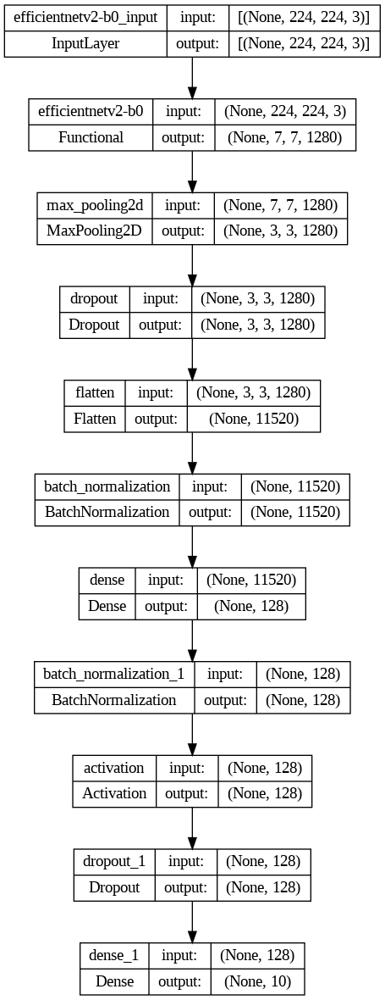

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
import tensorflow as tf
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('loss') < 0.03 and logs.get('val_accuracy') > 0.98):
      print("\Stopped, Akurasi mencapai 98%")
      self.model.stop_training = True;

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

# Tentukan path penyimpanan model
checkpoint_path = '/content/drive/MyDrive/Model3/EfficientNetV2B0'

# Buat callback ModelCheckpoint
checkpoint_callback = ModelCheckpoint(filepath=checkpoint_path,
                                      monitor='loss',
                                      save_best_only=True,
                                      save_weights_only=False,
                                      mode='min',
                                      verbose=1)

In [ ]:
from tensorflow.keras.optimizers import Adam
# Set the training parameters
callbacks= myCallback()
model.compile(optimizer = Adam(learning_rate=0.0001),
              loss=SparseCategoricalCrossentropy(),
              metrics = ['accuracy'])

In [ ]:
# Panggil model.fit di luar blok tf.function
with tf.device('/device:GPU:0'):
  history = model.fit(train_data, validation_data=val_data, epochs=10, batch_size=128, callbacks=([callbacks],[checkpoint_callback]))

Epoch 1/10
250/250 [==============================] - ETA: 0s - loss: 0.9218 - accuracy: 0.7132 
Epoch 1: loss improved from inf to 0.92179, saving model to /content/drive/MyDrive/Model3/EfficientNetV2B0


250/250 [==============================] - 3187s 13s/step - loss: 0.9218 - accuracy: 0.7132 - val_loss: 0.1199 - val_accuracy: 0.9830
Epoch 2/10
250/250 [==============================] - ETA: 0s - loss: 0.2205 - accuracy: 0.9609
Epoch 2: loss improved from 0.92179 to 0.22051, saving model to /content/drive/MyDrive/Model3/EfficientNetV2B0


250/250 [==============================] - 173s 682ms/step - loss: 0.2205 - accuracy: 0.9609 - val_loss: 0.0397 - val_accuracy: 0.9940
Epoch 3/10
250/250 [==============================] - ETA: 0s - loss: 0.1099 - accuracy: 0.9841
Epoch 3: loss improved from 0.22051 to 0.10990, saving model to /content/drive/MyDrive/Model3/EfficientNetV2B0
250/250 [==============================] - 171s 677ms/step - loss: 0.1099 - accuracy: 0.9841 - val_loss: 0.0207 - val_accuracy: 0.9970
Epoch 4/10
250/250 [==============================] - ETA: 0s - loss: 0.0718 - accuracy: 0.9901
Epoch 4: loss improved from 0.10990 to 0.07179, saving model to /content/drive/MyDrive/Model3/EfficientNetV2B0
250/250 [==============================] - 178s 703ms/step - loss: 0.0718 - accuracy: 0.9901 - val_loss: 0.0125 - val_accuracy: 0.9980
Epoch 5/10
250/250 [==============================] - ETA: 0s - loss: 0.0459 - accuracy: 0.9964
Epoch 5: loss improved from 0.07179 to 0.04594, saving model to /content/drive/MyDriv

### **Save Nodel Dalam Format Keras (H5)**

In [ ]:
MODEL_BASE_PATH = Path("/content/drive/MyDrive/Model3/EfficientNet")
PROJECT_NAME = "H5"
SAVE_MODEL_NAME = "EfficientNetV2B0.h5"
save_model_path = MODEL_BASE_PATH / PROJECT_NAME / SAVE_MODEL_NAME
project_path = MODEL_BASE_PATH / PROJECT_NAME
if not project_path.exists():
    project_path.mkdir(parents=True)
print(f'Saving Model At {save_model_path}...')
model.save(save_model_path, include_optimizer=False)

Saving Model At /content/drive/MyDrive/Model3/EfficientNet/H5/EfficientNetV2B0.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### **Plot Akurasi Setelah Pelatihan Model**

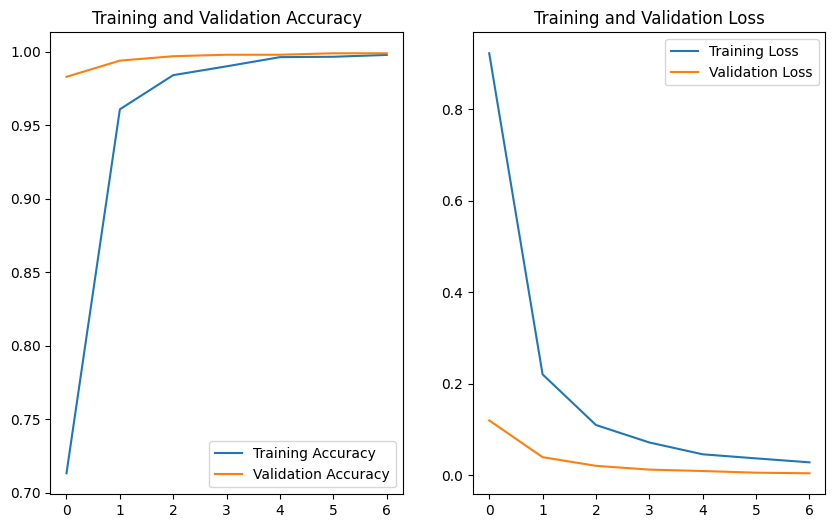

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = history.epoch

plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
model.evaluate(test_data)

32/32 [==============================] - 11s 273ms/step - loss: 0.0045 - accuracy: 0.9990


[0.004510893952101469, 0.9990000128746033]

In [ ]:
y_pred = model.predict(test_data)

32/32 [==============================] - 14s 258ms/step


In [ ]:
import numpy as np

predictions = model.predict(test_data)

y_pred = []
y_true = []

for image_batch, label_batch in test_data:
    y_true.append(label_batch)
    preds = model.predict(image_batch)
    y_pred.append(np.argmax(preds, axis = - 1))

true_labels = tf.concat([item for item in y_true], axis = 0)
predicted_labels = tf.concat([item for item in y_pred], axis = 0)

1/1 [==============================] - 0s 27ms/step


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(true_labels, predicted_labels, target_names=['Asoka', 'Bunga Telang', 'Daun Jambu Biji', 'Daun Jarak', 'Daun Jeruk Nipis', 'Daun Pepaya', 'Kayu Putih', 'Lidah Buaya', 'Semanggi', 'Sirih']))

                  precision    recall  f1-score   support

           Asoka       1.00      1.00      1.00        92
    Bunga Telang       1.00      0.99      1.00       109
 Daun Jambu Biji       1.00      1.00      1.00       109
      Daun Jarak       1.00      1.00      1.00       109
Daun Jeruk Nipis       1.00      1.00      1.00        97
     Daun Pepaya       1.00      1.00      1.00        92
      Kayu Putih       1.00      1.00      1.00       101
     Lidah Buaya       1.00      1.00      1.00       105
        Semanggi       1.00      1.00      1.00        90
           Sirih       0.99      1.00      0.99        96

        accuracy                           1.00      1000
       macro avg       1.00      1.00      1.00      1000
    weighted avg       1.00      1.00      1.00      1000



Text(0.5, 1.0, 'confusion matrix')

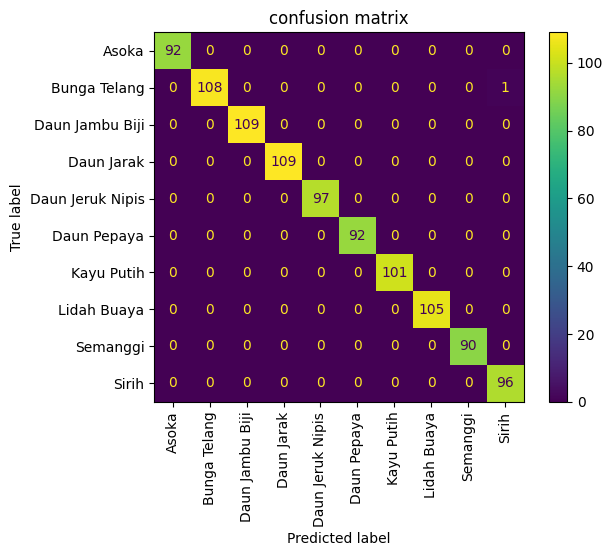

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(true_labels, predicted_labels)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Asoka', 'Bunga Telang', 'Daun Jambu Biji', 'Daun Jarak', 'Daun Jeruk Nipis', 'Daun Pepaya', 'Kayu Putih', 'Lidah Buaya', 'Semanggi', 'Sirih'])
disp.plot(xticks_rotation=90)
plt.title('confusion matrix')

In [ ]:
labels = train_data.class_names
def predict(model, img):

    img_array = img.numpy()
    img_array = expand_dims(img_array, 0)

    predictions = model.predict(img_array)

    predicted_class = labels[np.argmax(predictions[0])]
    confidence = round( (np.max(predictions[0])), 2)

    return predicted_class, confidence

1/1 [==============================] - 0s 27ms/step


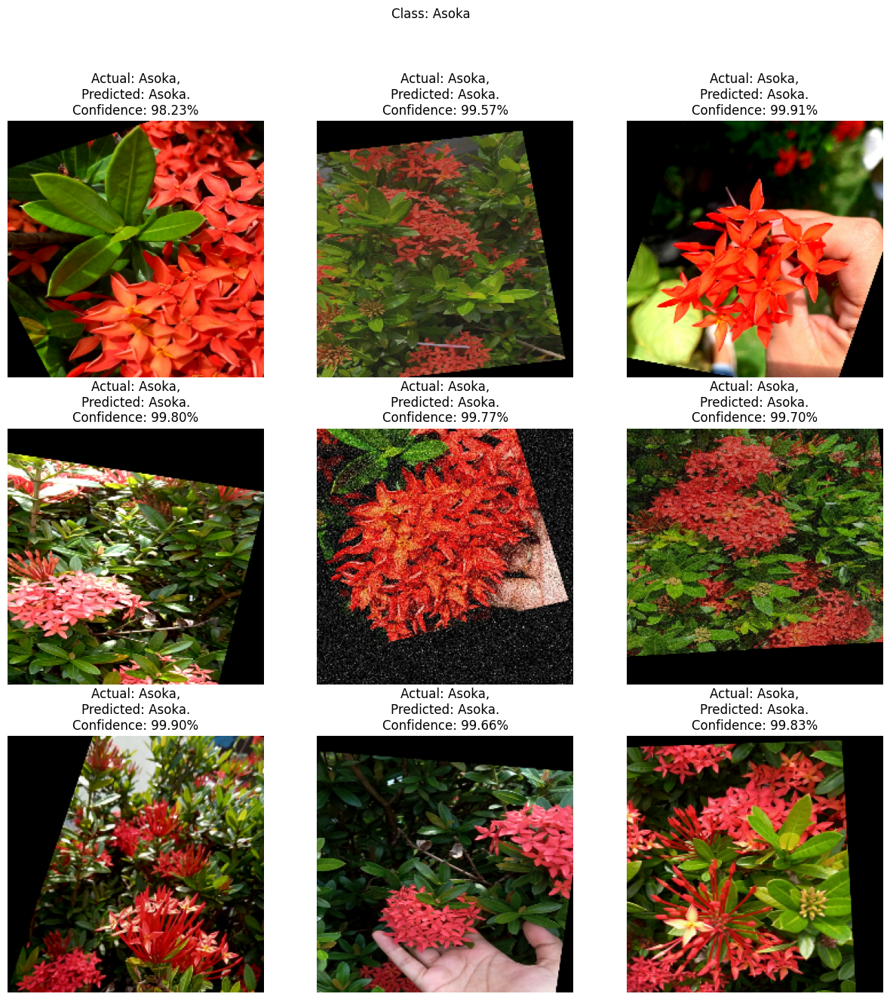

1/1 [==============================] - 0s 29ms/step


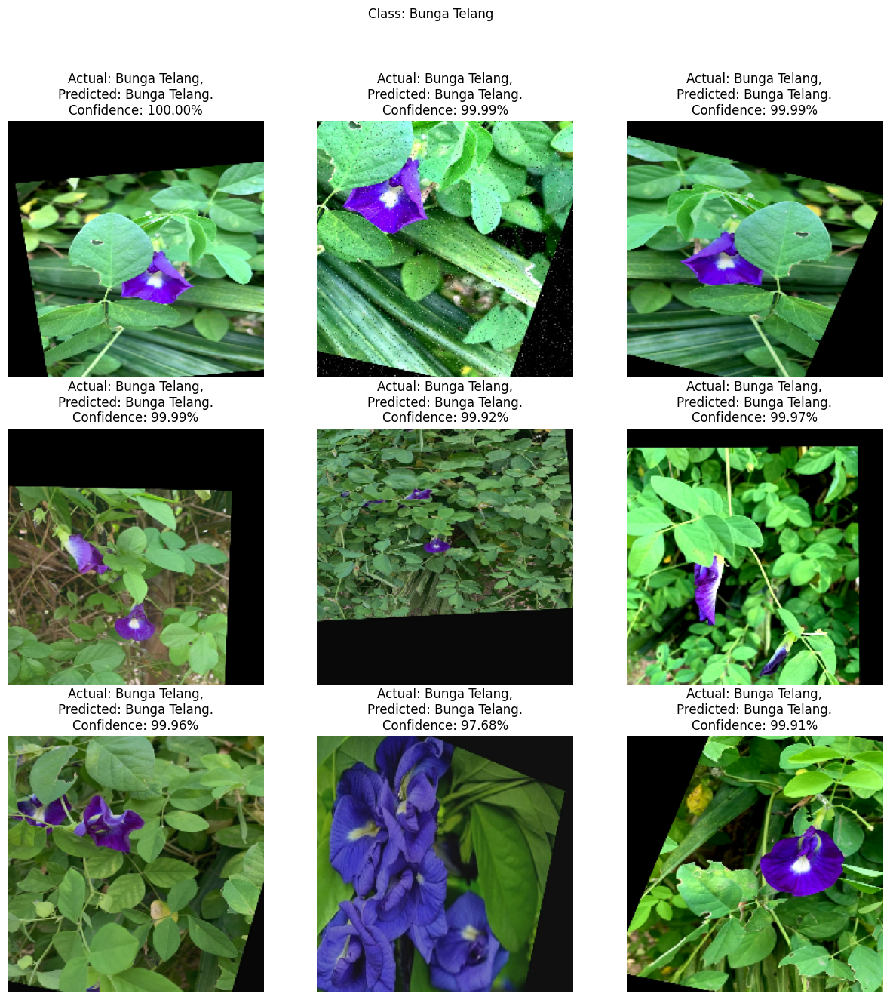

1/1 [==============================] - 0s 39ms/step


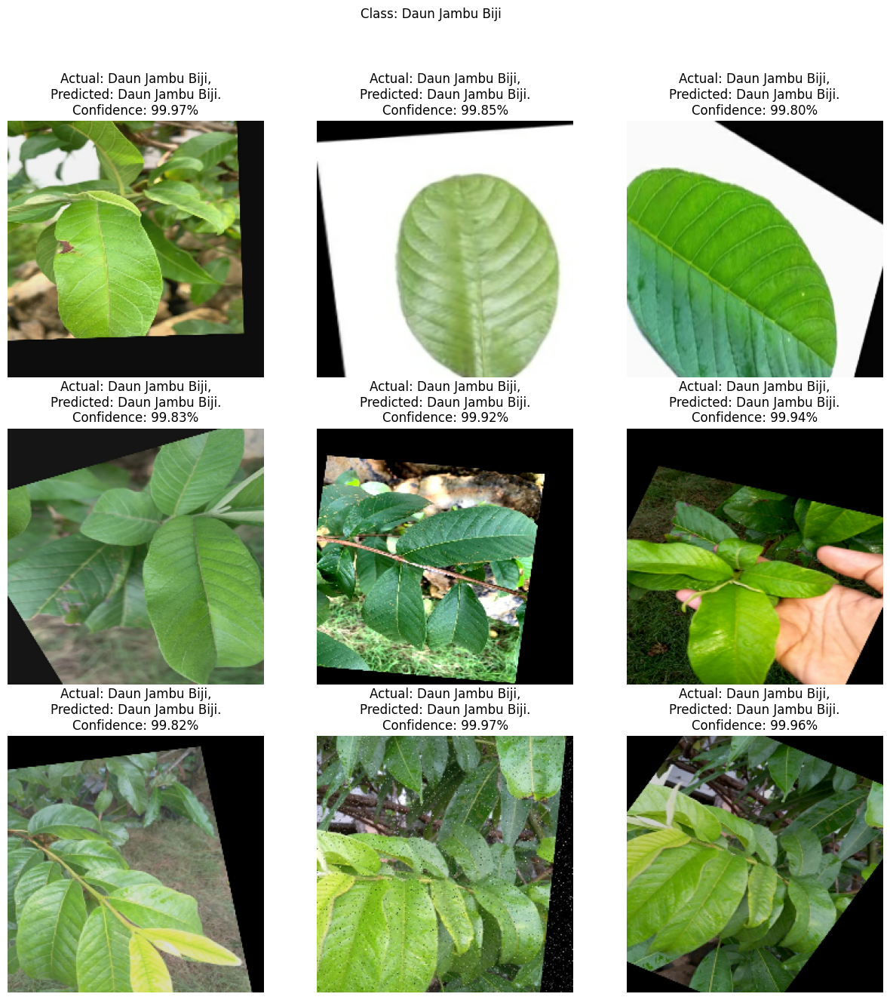

1/1 [==============================] - 0s 40ms/step


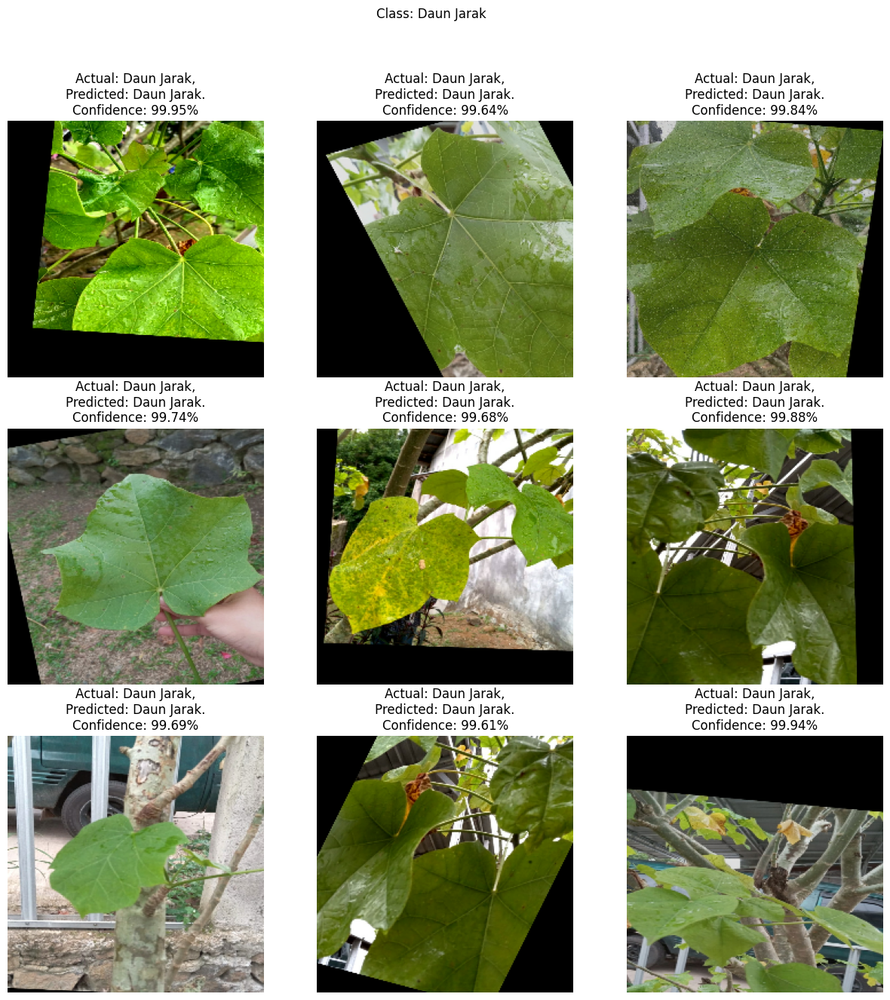

1/1 [==============================] - 0s 59ms/step


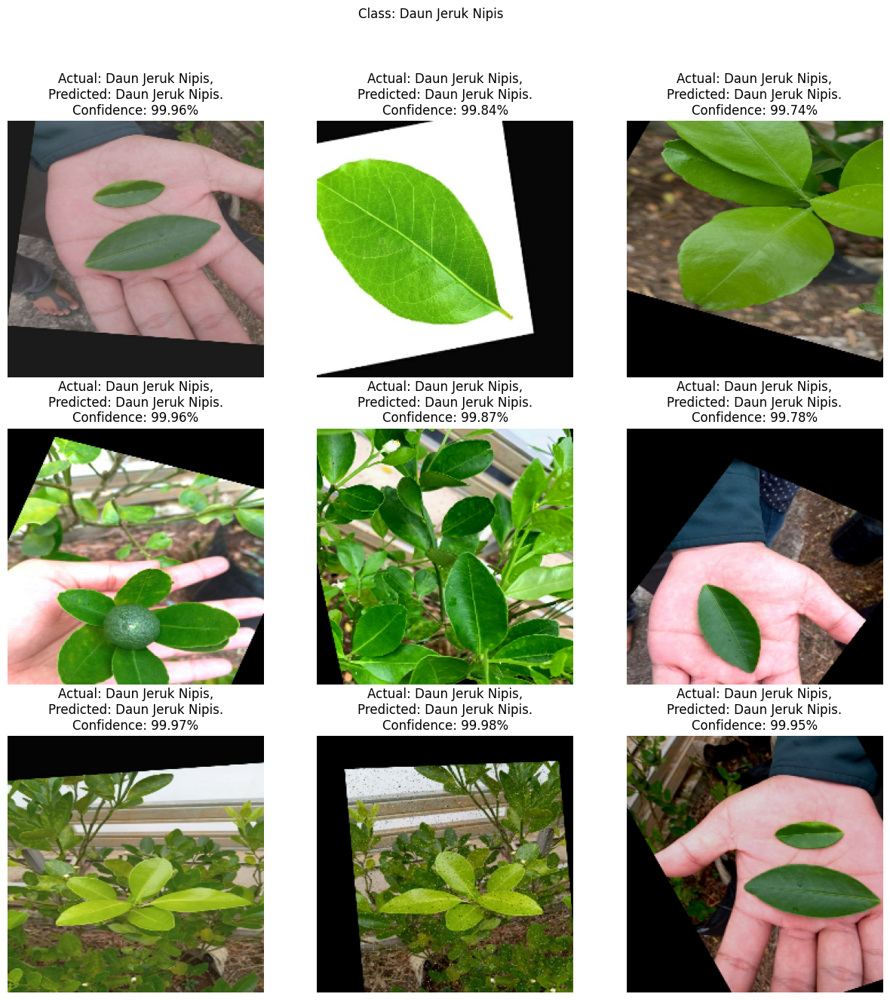

1/1 [==============================] - 0s 42ms/step


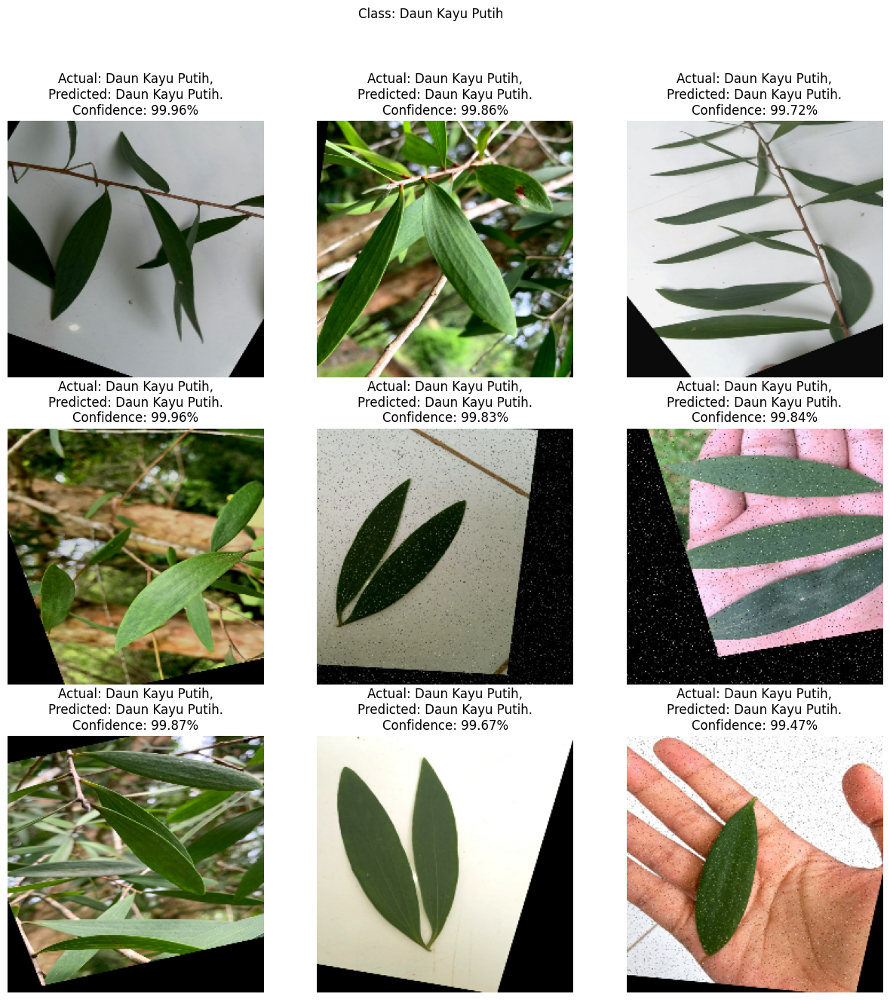

1/1 [==============================] - 0s 41ms/step


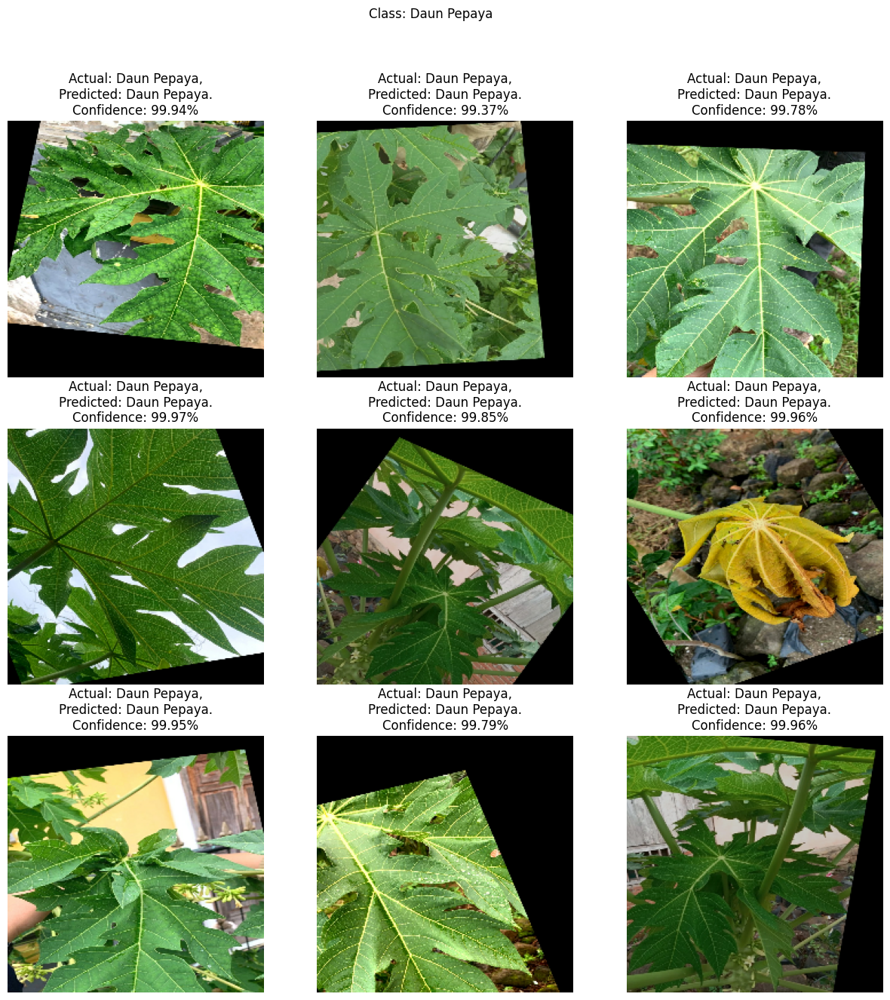

1/1 [==============================] - 0s 41ms/step


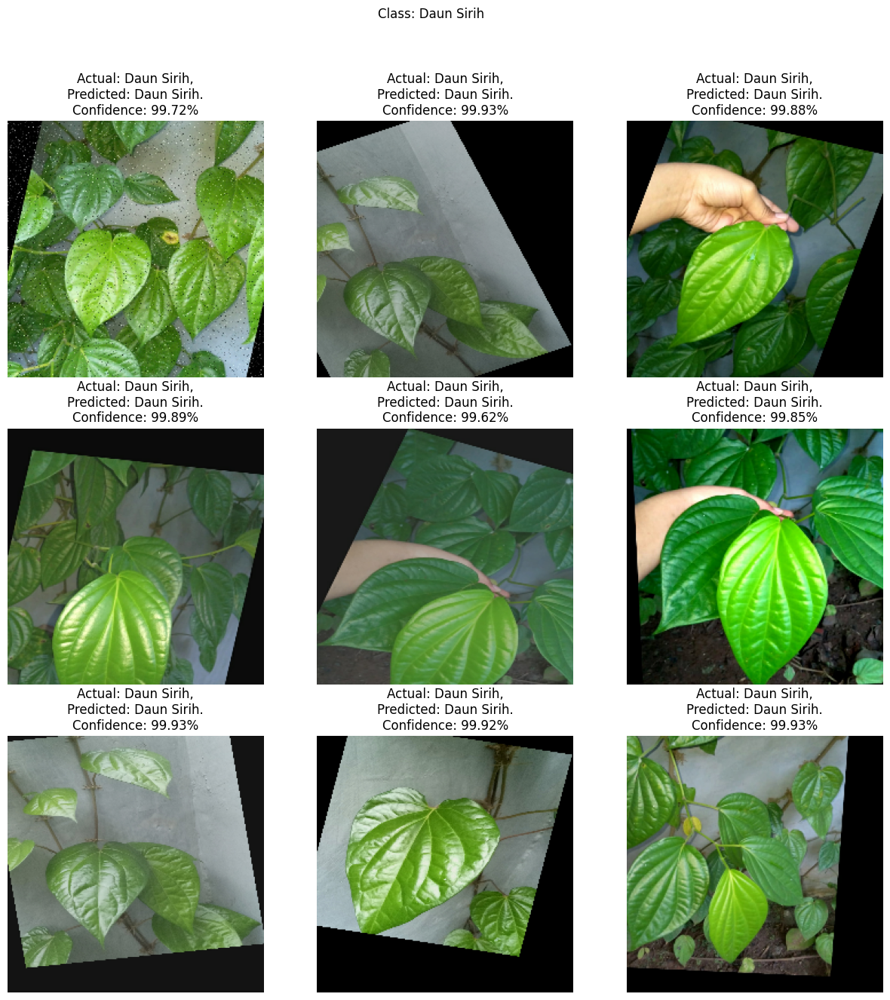

1/1 [==============================] - 0s 61ms/step


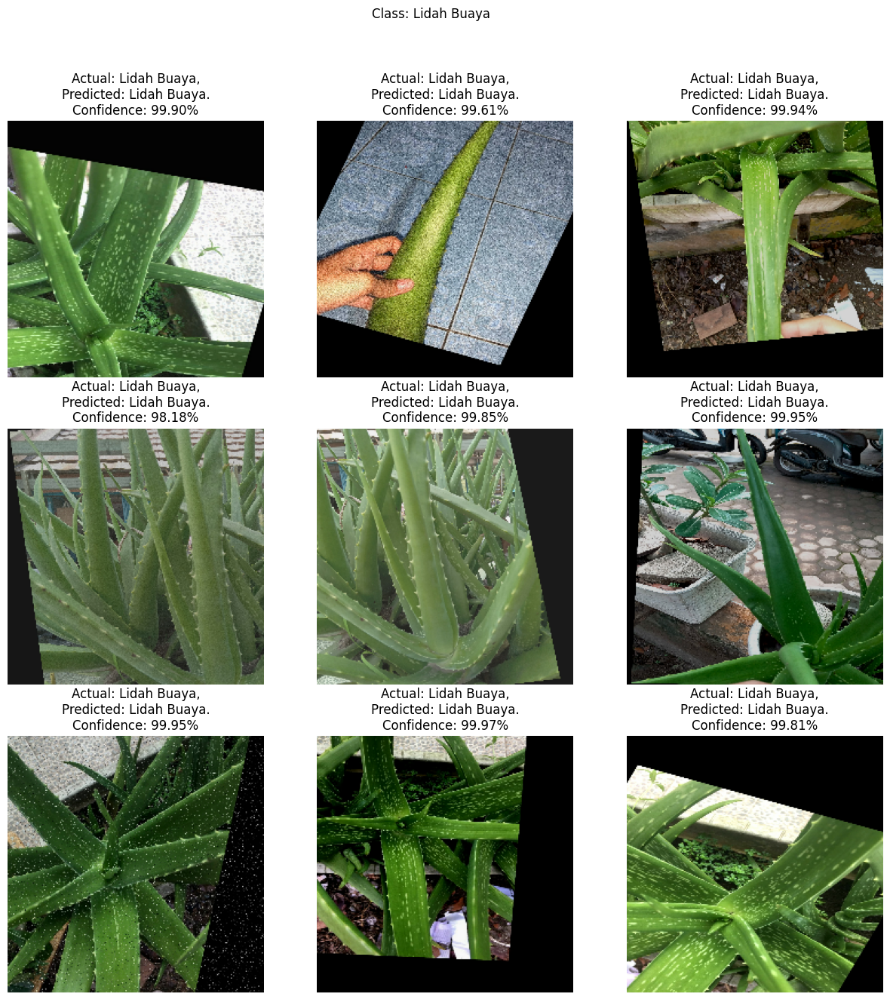

1/1 [==============================] - 0s 59ms/step


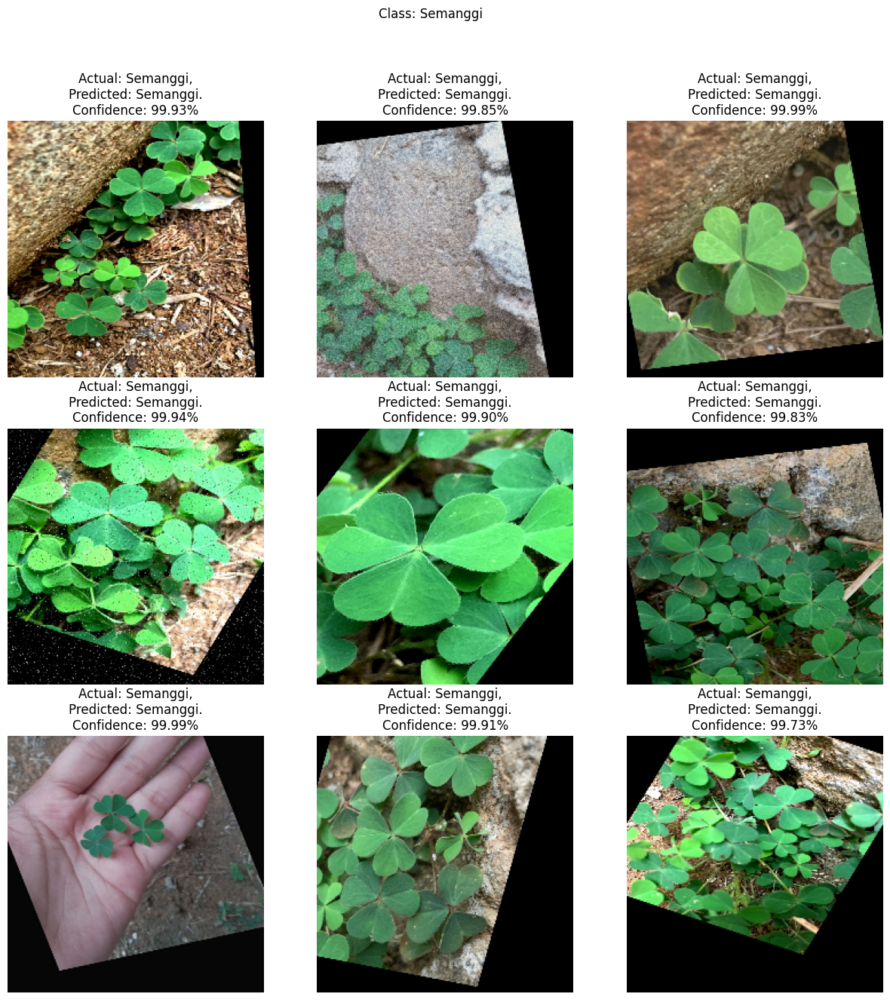

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow import expand_dims

# Definisikan fungsi prediksi
def predict(model, img):
    img_array = img.numpy()
    img_array = expand_dims(img_array, 0)
    predictions = model.predict(img_array)
    predicted_class = predictions.argmax(axis=-1)[0]
    confidence = predictions.max(axis=-1)[0]
    return predicted_class, confidence

# Dapatkan label dari dataset
labels = test_data.class_names

# Buat dictionary untuk menyimpan gambar berdasarkan kelas
class_images = {label: [] for label in labels}

# Ambil gambar dari data pengujian sampai setiap kelas memiliki 9 gambar
for images, lbs in test_data:
    for i in range(len(images)):
        actual_class = labels[lbs[i].numpy()]
        if len(class_images[actual_class]) < 9:
            class_images[actual_class].append(images[i])

    # Periksa apakah semua kelas sudah memiliki 9 gambar
    if all(len(img_list) == 9 for img_list in class_images.values()):
        break

# Plot gambar berdasarkan kelas
for class_name, images in class_images.items():
    plt.figure(figsize=(15, 15))
    for i in range(9):  # Pastikan kita memiliki 9 gambar per kelas
        plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))

        predicted_class, confidence = predict(model, images[i])
        actual_class = class_name

        plt.title(f"Actual: {actual_class},\nPredicted: {labels[predicted_class]}.\nConfidence: {confidence*100:.2f}%")
        plt.axis("off")

    plt.suptitle(f"Class: {class_name}")
    plt.show()


### **Mengetes Model yang Telah dibuat**

Model loaded successfully.
1/1 [==============================] - 2s 2s/step


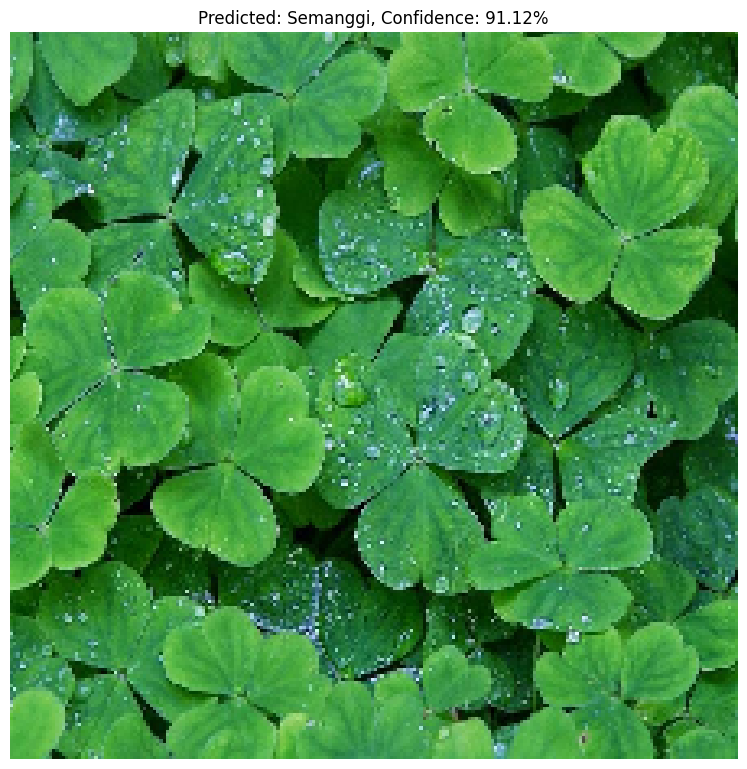

In [7]:
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
import numpy as np

# Load the model in the SavedModel format
model_path = '/content/drive/MyDrive/Model3/EfficientNet/H5/EfficientNetV2B0.h5'
try:
    model = tf.keras.models.load_model(model_path)
    print("Model loaded successfully.")
except Exception as e:
    print(f"Error loading model: {e}")

# Function to load and process images
def load_and_process_image(image_path, target_size=(224, 224)):
    img = image.load_img(image_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = tf.keras.applications.efficientnet.preprocess_input(img_array)
    return img, img_array

# Specify image paths for testing
image_paths = [
    '/content/semanggi2.jpg',
    # Add more image paths here
]

# Class names
class_names = ['Asoka', 'Bunga Telang', 'Daun Jambu Biji', 'Daun Jarak', 'Daun Jeruk Nipis', 'Kayu Putih', 'Daun Pepaya', 'Sirih', 'Lidah Buaya', 'Semanggi']

# Calculate number of rows and columns for subplots
num_images = len(image_paths)
num_cols = 2
num_rows = (num_images + 1) // num_cols

# Visualization of prediction results
plt.figure(figsize=(15, 10))
for i, image_path in enumerate(image_paths):
    plt.subplot(num_rows, num_cols, i + 1)

    # Load and process the image
    img, img_array = load_and_process_image(image_path, target_size=(224, 224))

    # Make prediction
    try:
        predictions = model.predict(img_array)
        predicted_class = tf.argmax(predictions[0]).numpy()
        confidence = predictions[0][predicted_class]

        # Display image with predicted label and confidence
        plt.imshow(img)
        plt.title(f"Predicted: {class_names[predicted_class]}, Confidence: {confidence*100:.2f}%")
        plt.axis('off')
    except Exception as e:
        print(f"Error making prediction: {e}")
        plt.imshow(img)
        plt.title("Error in prediction")
        plt.axis('off')

plt.tight_layout()
plt.show()
